In [1]:
import pandas as pd
from pycaret import *
import os

In [2]:
data_loc='./data'

In [3]:
data=pd.read_csv(os.path.join(data_loc,'train.csv'))
data.head()

,duration,protocol_type,service,flag,src_bytes,dst_bytes,land,wrong_fragment,urgent,hot,...,dst_host_srv_count,dst_host_same_srv_rate,dst_host_diff_srv_rate,dst_host_same_src_port_rate,dst_host_srv_diff_host_rate,dst_host_serror_rate,dst_host_srv_serror_rate,dst_host_rerror_rate,dst_host_srv_rerror_rate,class
0,0,tcp,ftp_data,SF,491,0,0,0,0,0,...,25,0.17,0.03,0.17,0.00,0.00,0.00,0.05,0.00,normal
1,0,udp,other,SF,146,0,0,0,0,0,...,1,0.00,0.60,0.88,0.00,0.00,0.00,0.00,0.00,normal
2,0,tcp,private,S0,0,0,0,0,0,0,...,26,0.10,0.05,0.00,0.00,1.00,1.00,0.00,0.00,anomaly
3,0,tcp,http,SF,232,8153,0,0,0,0,...,255,1.00,0.00,0.03,0.04,0.03,0.01,0.00,0.01,normal
4,0,tcp,http,SF,199,420,0,0,0,0,...,255,1.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,normal


In [4]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25192 entries, 0 to 25191
Data columns (total 42 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   duration                     25192 non-null  int64  
 1   protocol_type                25192 non-null  object 
 2   service                      25192 non-null  object 
 3   flag                         25192 non-null  object 
 4   src_bytes                    25192 non-null  int64  
 5   dst_bytes                    25192 non-null  int64  
 6   land                         25192 non-null  int64  
 7   wrong_fragment               25192 non-null  int64  
 8   urgent                       25192 non-null  int64  
 9   hot                          25192 non-null  int64  
 10  num_failed_logins            25192 non-null  int64  
 11  logged_in                    25192 non-null  int64  
 12  num_compromised              25192 non-null  int64  
 13  root_shell      

In [5]:
cat_features=['protocol_type','service','flag','class']
temp_data=data.drop(columns=cat_features)
num_features=temp_data.columns.tolist()
print(num_features)

['duration', 'src_bytes', 'dst_bytes', 'land', 'wrong_fragment', 'urgent', 'hot', 'num_failed_logins', 'logged_in', 'num_compromised', 'root_shell', 'su_attempted', 'num_root', 'num_file_creations', 'num_shells', 'num_access_files', 'num_outbound_cmds', 'is_host_login', 'is_guest_login', 'count', 'srv_count', 'serror_rate', 'srv_serror_rate', 'rerror_rate', 'srv_rerror_rate', 'same_srv_rate', 'diff_srv_rate', 'srv_diff_host_rate', 'dst_host_count', 'dst_host_srv_count', 'dst_host_same_srv_rate', 'dst_host_diff_srv_rate', 'dst_host_same_src_port_rate', 'dst_host_srv_diff_host_rate', 'dst_host_serror_rate', 'dst_host_srv_serror_rate', 'dst_host_rerror_rate', 'dst_host_srv_rerror_rate']


In [6]:
updated_data=data.copy()
for i in updated_data:
    if i in num_features:
        updated_data[i]=updated_data[i].astype(float)
    else:
        updated_data[i]=updated_data[i].astype('category')

updated_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25192 entries, 0 to 25191
Data columns (total 42 columns):
 #   Column                       Non-Null Count  Dtype   
---  ------                       --------------  -----   
 0   duration                     25192 non-null  float64 
 1   protocol_type                25192 non-null  category
 2   service                      25192 non-null  category
 3   flag                         25192 non-null  category
 4   src_bytes                    25192 non-null  float64 
 5   dst_bytes                    25192 non-null  float64 
 6   land                         25192 non-null  float64 
 7   wrong_fragment               25192 non-null  float64 
 8   urgent                       25192 non-null  float64 
 9   hot                          25192 non-null  float64 
 10  num_failed_logins            25192 non-null  float64 
 11  logged_in                    25192 non-null  float64 
 12  num_compromised              25192 non-null  float64 
 13  r

Applying Classification Technique

Base estimators are built sequentially and one tries to reduce the bias of the combined estimator. The motivation is to combine several weak models to produce a powerful ensemble. Examples: AdaBoost, Gradient Tree Boosting.

In [7]:
from pycaret.classification import *

In [8]:
test_data=pd.read_csv(os.path.join(data_loc,'test.csv'))

print(updated_data.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25192 entries, 0 to 25191
Data columns (total 42 columns):
 #   Column                       Non-Null Count  Dtype   
---  ------                       --------------  -----   
 0   duration                     25192 non-null  float64 
 1   protocol_type                25192 non-null  category
 2   service                      25192 non-null  category
 3   flag                         25192 non-null  category
 4   src_bytes                    25192 non-null  float64 
 5   dst_bytes                    25192 non-null  float64 
 6   land                         25192 non-null  float64 
 7   wrong_fragment               25192 non-null  float64 
 8   urgent                       25192 non-null  float64 
 9   hot                          25192 non-null  float64 
 10  num_failed_logins            25192 non-null  float64 
 11  logged_in                    25192 non-null  float64 
 12  num_compromised              25192 non-null  float64 
 13  r

In [10]:
classy=setup(data=updated_data,target='class',preprocess=True,imputation_type='iterative',use_gpu=True,n_jobs=-1,iterative_imputation_iters=20,train_size=0.85,numeric_features=num_features,numeric_imputation='mean',categorical_features=['protocol_type','service','flag'],categorical_imputation='mode',categorical_iterative_imputer='lightgbm')

,Description,Value
0,session_id,989
1,Target,class
2,Target Type,Binary
3,Label Encoded,"anomaly: 0, normal: 1"
4,Original Data,"(25192, 42)"
5,Missing Values,False
6,Numeric Features,38
7,Categorical Features,3
8,Ordinal Features,False
9,High Cardinality Features,False


In [11]:
top=compare_models()

,Model,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC,TT (Sec)
lightgbm,Light Gradient Boosting Machine,0.9980,1.0000,0.9989,0.9974,0.9981,0.9960,0.9960,0.9150
rf,Random Forest Classifier,0.9978,1.0000,0.9991,0.9968,0.9979,0.9956,0.9956,2.7500
et,Extra Trees Classifier,0.9975,0.9999,0.9990,0.9963,0.9976,0.9949,0.9949,3.5740
dt,Decision Tree Classifier,0.9965,0.9964,0.9968,0.9966,0.9967,0.9929,0.9929,0.3240
gbc,Gradient Boosting Classifier,0.9950,0.9997,0.9963,0.9944,0.9954,0.9901,0.9901,10.0860
ada,Ada Boost Classifier,0.9893,0.9989,0.9912,0.9888,0.9900,0.9784,0.9784,2.6310
knn,K Neighbors Classifier,0.9851,0.9957,0.9855,0.9865,0.9860,0.9700,0.9700,3.7870
ridge,Ridge Classifier,0.9669,0.0000,0.9830,0.9564,0.9695,0.9334,0.9339,0.1390
lda,Linear Discriminant Analysis,0.9668,0.9931,0.9827,0.9565,0.9694,0.9332,0.9337,1.2500
lr,Logistic Regression,0.8879,0.9505,0.9403,0.8624,0.8997,0.7733,0.7770,1.3970


In [12]:
lightgbm=create_model(estimator='lightgbm',fold=20,round=4,cross_validation=True)

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9963,1.0000,1.0000,0.9931,0.9965,0.9925,0.9925
1,0.9991,1.0000,0.9983,1.0000,0.9991,0.9981,0.9981
2,0.9981,1.0000,1.0000,0.9965,0.9983,0.9962,0.9963
3,0.9972,1.0000,1.0000,0.9948,0.9974,0.9944,0.9944
4,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
5,0.9953,0.9999,0.9948,0.9965,0.9956,0.9906,0.9906
6,0.9963,0.9997,0.9965,0.9965,0.9965,0.9925,0.9925
7,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
8,0.9991,1.0000,1.0000,0.9983,0.9991,0.9981,0.9981
9,0.9953,1.0000,0.9965,0.9948,0.9956,0.9906,0.9906


In [14]:
tuned_lightgbm=tune_model(lightgbm,fold=20,round=4,n_iter=20,optimize='Accuracy')

,Accuracy,AUC,Recall,Prec.,F1,Kappa,MCC
0,0.9963,0.9999,1.0000,0.9931,0.9965,0.9925,0.9925
1,0.9991,1.0000,0.9983,1.0000,0.9991,0.9981,0.9981
2,0.9991,1.0000,1.0000,0.9983,0.9991,0.9981,0.9981
3,0.9981,1.0000,1.0000,0.9965,0.9983,0.9962,0.9963
4,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
5,0.9953,1.0000,0.9965,0.9948,0.9956,0.9906,0.9906
6,0.9972,0.9997,0.9965,0.9982,0.9974,0.9944,0.9944
7,0.9991,1.0000,1.0000,0.9983,0.9991,0.9981,0.9981
8,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000,1.0000
9,0.9981,0.9999,1.0000,0.9965,0.9983,0.9962,0.9963


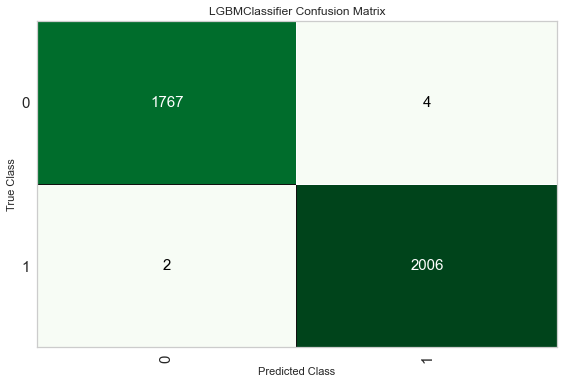

In [17]:
plot_model(tuned_lightgbm,plot='confusion_matrix')

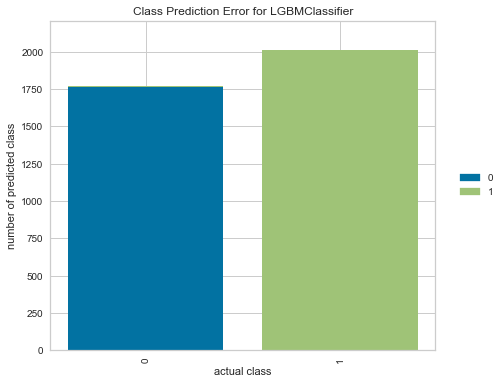

In [19]:
plot_model(tuned_lightgbm,plot='error')

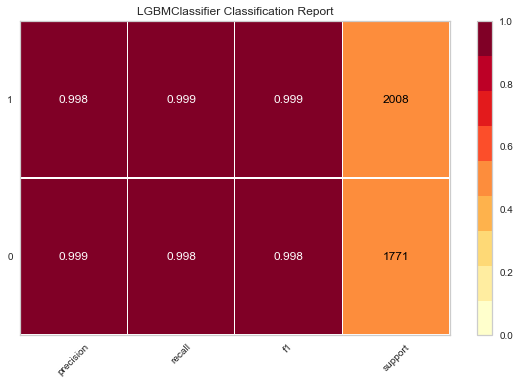

In [20]:
plot_model(tuned_lightgbm,plot='class_report')

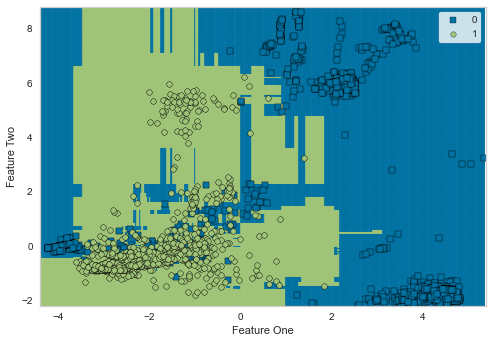

In [21]:
plot_model(tuned_lightgbm,plot='boundary')

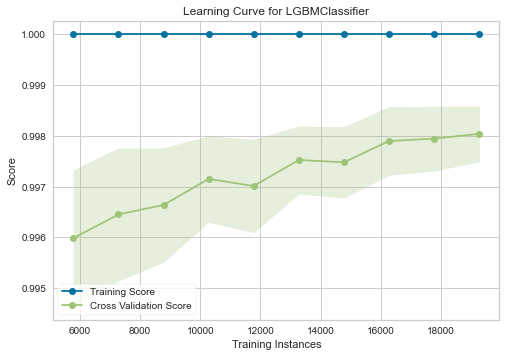

In [22]:
plot_model(tuned_lightgbm,plot='learning')

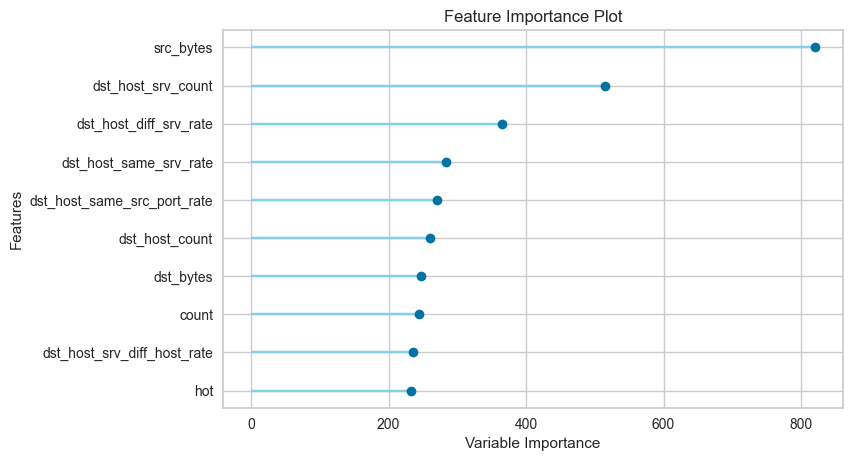

In [23]:
plot_model(tuned_lightgbm,plot='feature')

Finalizing a Model will also train the Holdout Set of data thus providing us the efficient result

In [26]:
finalized_lightgbm=finalize_model(tuned_lightgbm)

[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] bagging_fraction is set=0.6, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] bagging_fraction is set=0.6, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 will be ignored. Current value: bagging_freq=1
[LightGBM] [Warning] feature_fraction is set=0.9, colsample_bytree=1.0 will be ignored. Current value: feature_fraction=0.9
[LightGBM] [Warning] bagging_fraction is set=0.6, subsample=1.0 will be ignored. Current value: bagging_fraction=0.6
[LightGBM] [Warning] bagging_freq is set=1, subsample_freq=0 

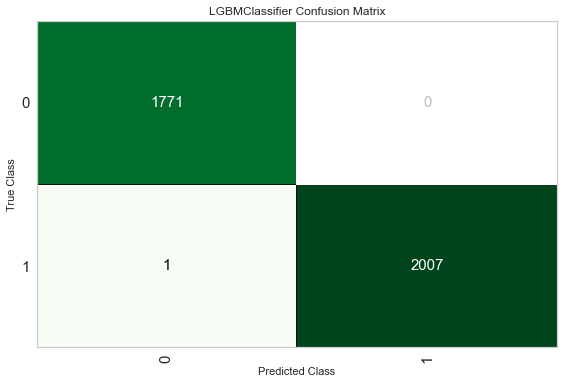

In [27]:
plot_model(finalized_lightgbm,plot='confusion_matrix')

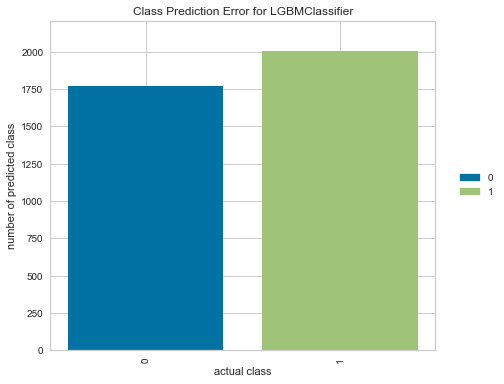

In [28]:
plot_model(finalized_lightgbm,plot='error')

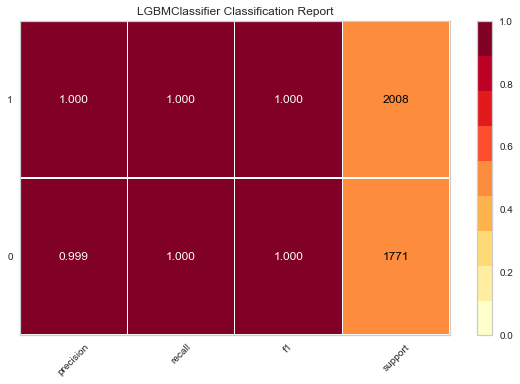

In [29]:
plot_model(finalized_lightgbm,plot='class_report')

In [31]:
save_model(model=finalized_lightgbm,model_name='./model/intrusion_model')

Transformation Pipeline and Model Succesfully Saved


(Pipeline(memory=None,
          steps=[('dtypes',
                  DataTypes_Auto_infer(categorical_features=['protocol_type',
                                                             'service', 'flag'],
                                       display_types=True, features_todrop=[],
                                       id_columns=[],
                                       ml_usecase='classification',
                                       numerical_features=['duration',
                                                           'src_bytes',
                                                           'dst_bytes', 'land',
                                                           'wrong_fragment',
                                                           'urgent', 'hot',
                                                           'num_failed_logins',
                                                           'logged_in',
                                                           'n